# Analyzing Cosmological simulations with pyEXP
In this tutorial, we will compute a BFE from the particle data from Halo 349 of the MW-est zoom-in DM-only cosmological simulation.
The data to reproduce this analysis can be downloaded from this link:


Dependencies: 
- numpy, scipy, matplotlib, and pyEXP

I am using the Docker pyEXP image for Ubuntu+22 which can be downloaded here:  https://github.com/EXP-code/EXP-container/blob/main/Docker/Dockerfile22. Note that his image already has the numpy, scipy and matplotib libraries. 


In [53]:
%matplotlib inline
import numpy as np
from scipy.interpolate import interp1d, BSpline, splrep
import matplotlib.pyplot as plt
import pyEXP
from matplotlib.colors import LogNorm #import #EXPtools
import makemodel
from inspect import getmembers, isfunction
import pickle
import os
plt.style.use('../../../MW_viz/matplotlib.mplstyle')


In [74]:
plt.rcParams['text.usetex'] = False

In [4]:
DATAPATH = "../../data/"


In [7]:
def load_halo(Halo, snap):
    """
    Function to load halo phase-space particle coordinates
    """
    halo = np.load(DATAPATH + "{}/{}_{:03d}.npy".format(Halo, Halo, snap))
    h = {'position': halo['x'], 'velocity': halo['v']}
    return halo['x']

### Snapshots where the analysis for the halos started

In [13]:
halos_init_snap = {'Halo004':243-25 , 'Halo113':243-26 , 'Halo169':243-31 , 'Halo170':243-28 , 'Halo222':243-24, 'Halo229':240-81, 
                   'Halo282':243-23 , 'Halo327':243-33,  'Halo349':243-36, 'Halo407':243-25, 'Halo659':243-74, 'Halo666':243-27,
                   'Halo719':243-25, 'Halo747':243-27, 'Halo756':243-27, 'Halo788':235-19, 'Halo975':235-18, 'Halo983':235-18 }

### Data with the properties of the LMC-like satellites orbits 

In [11]:

with open('../../data/NICO_PICKLE/times.pickle', 'rb') as f:
    times =  pickle.load(f)

with open('../../data/NICO_PICKLE/tpericenter.pickle', 'rb') as f:
    tpericenter = pickle.load(f)

with open('../../data/NICO_PICKLE/'+'orbits_rotated.pickle', 'rb') as f:
    orbits = pickle.load(f)
    
halos = list(times.keys())


### Let's load the halo particle data and visualized it

In [14]:
snap = halos_init_snap['Halo349']
pos = load_halo('Halo349', snap)

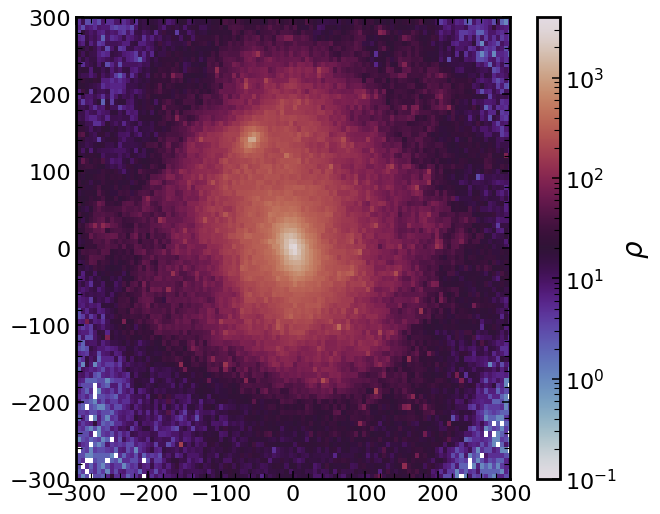

In [15]:
fig, ax = plt.subplots(1, 1, figsize=(7,6))
im  = ax.hist2d(pos[:,0], pos[:,1], bins=200, norm=LogNorm(vmin=0.1, vmax=4e3), cmap='twilight');
cb=fig.colorbar(im[3], ax=ax)
cb.set_label(r'$\rho$')
ax.set_xlim(-300, 300)
ax.set_ylim(-300, 300)
plt.Circle((0,0), 300, color='w', ls='--')

## EXP units and parameters

In [17]:
# EXP units and parameters 
Renc = 150 # Maximum radius to build the basis
Rin = 0.5
Rbins = 1000 # Number of bins 
rvals_lin = np.linspace(Rin, Renc, Rbins) # Choosing bins
rvals_log = np.logspace(np.log10(Rin), np.log10(Renc), Rbins) # Choosing bins

nparticles = len(pos)
print(nparticles)
mp = 402830.0 # Msun 

748112


In [18]:
## Compute enclosed mass

In [19]:
rhalo = np.sqrt(np.sum(pos**2, axis=1))
enc = np.where(rhalo<rvals_lin[-1])
Menc = len(enc[0])
Mtot = nparticles 
Mfrac = Menc/Mtot
print(Rbins, Menc, Mtot, Mfrac)

1000 295000 748112 0.3943259832752315


### Now we need to specify the type of basis that we want to use. For this we will use the profiles included in makemodel.

In [22]:
r_emp_lin_smooth, rho_emp_lin_smooth = makemodel.empirical_density_profile(rvals_lin, pos, mass=np.ones(len(rhalo))*mp, 
                                                                        smooth_length=1.5)

Text(0, 0.5, 'Density')

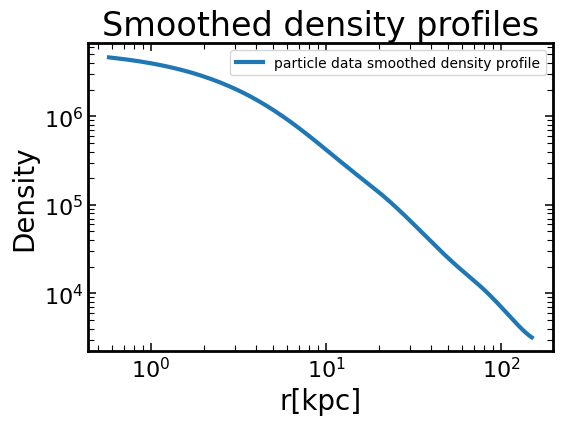

In [28]:
fig, ax = plt.subplots(1, 1, figsize=(6, 4), sharey=True)
ax.set_title('Smoothed density profiles')
ax.loglog(r_emp_lin_smooth, rho_emp_lin_smooth, label='particle data smoothed density profile')
plt.legend()
plt.xlabel('r[kpc]')
plt.ylabel('Density')

# We will now built the basis using and NFW profile

### 1. Make the model 

# Let's build the basis

In [29]:
## Discuss the parameters of the cofig herE:

In [30]:
# What will be the rmapping?
rs = 25 # Scale Length
rmax = 150 # Rmax
rmapping = rs/rmax # rmapping is relative to rmax

In [31]:
rmapping  = rs/rmax
print(rmapping)

0.16666666666666666


In [32]:
Rnfw, Dnfw, Mnfw, Pnfw = makemodel.makemodel(makemodel.powerhalo, M=Mfrac*mp*Menc,
                                 funcargs=([25.0, 0, 1, 2]),rvals=rvals_lin,
                                 pfile='mwest349_220_nfw.txt')

! Scaling: R= 150.0   M= 46859669073.61465
0.9999999999999999 219236.61240093497 219236.61240093497 219236.61240093497


In [33]:
basis_config = """
id         : sphereSL
parameters :
  numr     : 1000
  rmin     : 0.99999
  rmax     : 150
  Lmax     : 5
  nmax     : 10
  rmapping  : 0.0166666
  modelname : mwest349_220_nfw.txt
  cachename : mwest349_220_nfw.cache
"""
symphony_basis = pyEXP.basis.Basis.factory(basis_config)

---- SLGridSph::ReadH5Cache: successfully read basis cache <mwest349_220_nfw.cache>
---- Spherical::orthoTest: worst=0.0454603


In [34]:
symbasis = symphony_basis.getBasis(1.5, 2.99, 999)

In [36]:
symbasis[0][0]['density'].shape

(999,)

## Compute coefficients

In [40]:
hh = 'Halo349'

snap = halos_init_snap[hh]
nsnaps = len(times[hh])
symphony_coef = symphony_basis.createFromArray(np.ones(1), pos[0], time=round(times[hh][0], 2))
halo_coefs = pyEXP.coefs.Coefs.makecoefs(symphony_coef, hh)
for j in range(nsnaps):
    pos = load_halo(hh, snap+j)
    nparticles = len(pos)
    symphony_coef = symphony_basis.createFromArray(np.ones(nparticles), pos, time=round(times[hh][j], 2))
    halo_coefs.add(symphony_coef)
print('-> Writing coefficients')
halo_coefs.WriteH5Coefs("../data/MWest_coefficients_{}.h5".format(hh))

-> Writing coefficients


HDF5-DIAG: Error detected in HDF5 (1.10.10) thread 1:
  #000: ../../../src/H5A.c line 270 in H5Acreate2(): unable to create attribute
    major: Attribute
    minor: Unable to initialize object
  #001: ../../../src/H5Aint.c line 155 in H5A__create(): attribute already exists
    major: Attribute
    minor: Object already exists
Unable to create the attribute "CoefficientOutputVersion": (Attribute) Object already exists


In [41]:
halo_coefs.getAllCoefs().shape

(21, 10, 37)

Text(0, 0.5, '$W_1/W_0$')

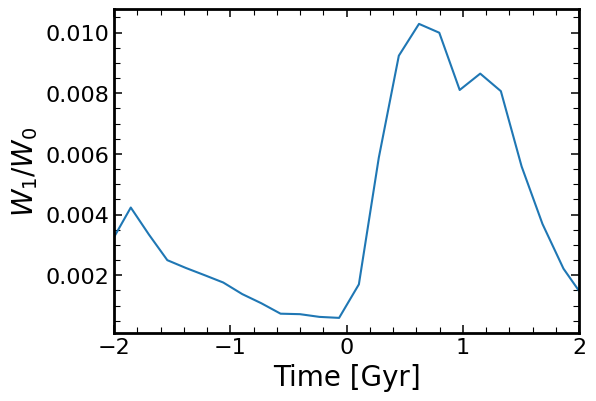

In [44]:
mwest_coefs = pyEXP.coefs.Coefs.factory('../data/MWest_coefficients_{}.h5'.format(hh))
plt.plot(times[hh]-tpericenter[hh], mwest_coefs.Power()[:,1]/mwest_coefs.Power()[:,0], lw=1.5)
plt.xlim(-2, 2)
plt.xlabel('Time [Gyr]')
plt.ylabel(r'$W_1/W_0$')

# Compute fields

In [167]:
#EXPtools.visuals.spherical_avg_prop(symphony_basis, symphony_coef, r_emp_lin, property='dens')

In [45]:
def l_indices(l):
    lm_idx = []
    for m in range(l+1):
        lm_idx.append(int(l*(l+1) / 2) + m)
    return lm_idx

In [46]:
def make_l1_l2_coefficients(coefs, nmax=10):
    dipole_indx = l_indices(1)
    quad_indx = l_indices(2)
    coefs_mat = coefs.getAllCoefs()
    dip_coefs_mat = np.zeros_like(coefs_mat)
    quad_coefs_mat = np.zeros_like(coefs_mat)
    dipole_coefs = coefs.deepcopy()
    quad_coefs = coefs.deepcopy()
    
    for t in range(len(coefs.Times())):
        for n in range(nmax):
            for idz in dipole_indx:
                dip_coefs_mat[idz, n, t] = coefs_mat[idz, n, t]
            for idz in quad_indx:
                quad_coefs_mat[idz, n, t] = coefs_mat[idz, n, t]
        dipole_coefs.setMatrix(time=coefs.Times()[t], mat=dip_coefs_mat[:,:,t])
        quad_coefs.setMatrix(time=coefs.Times()[t], mat=quad_coefs_mat[:,:,t])
    return dipole_coefs, quad_coefs

In [86]:
def compute_surfaces(times, halo_coefs, dipole_coefs, quad_coefs, proj='XY', deltaZ = 25, field='dens' , nslices=100, dl=150):
    
    nfw_volume = np.zeros((nslices, 100, 100))
    mon_volume = np.zeros((nslices, 100, 100))
    non_mon_volume = np.zeros((nslices, 100, 100))
    dipole_volume = np.zeros((nslices, 100, 100))
    quad_volume = np.zeros((nslices, 100, 100))
    
    z_sice = np.linspace(-deltaZ, deltaZ, nslices)
    
    for i in range(len(z_sice)):
        if proj == 'XY':
            pmin  = [-dl, -dl, z_sice[i]]
            pmax  = [ dl, dl, z_sice[i]]
            grid  = [ 100, 100, 0]
        elif proj == 'XZ':
            pmin  = [-dl, z_sice[i], -dl]
            pmax  = [ dl, z_sice[i], dl]
            grid  = [ 100, 0, 100]
        elif proj == 'YZ':
            pmin  = [z_sice[i], -dl, -dl]
            pmax  = [z_sice[i], dl, dl]
            grid  = [ 0, 100, 100]
            
        fields = pyEXP.field.FieldGenerator([times], pmin, pmax, grid)
        
        surfaces = fields.slices(symphony_basis, halo_coefs)
        dipole_surfaces = fields.slices(symphony_basis, dipole_coefs)
        quad_surfaces = fields.slices(symphony_basis, quad_coefs)
        
        nfw_volume[i] = surfaces[times]['{}'.format(field)]
        mon_volume[i] = surfaces[times]['{} m=0'.format(field)]
    
        dipole_volume[i] = dipole_surfaces[times]['{} m>0'.format(field)]
        quad_volume[i] = quad_surfaces[times]['{} m>0'.format(field)]
    
        non_mon_volume[i] = surfaces[times]['{} m>0'.format(field)]

    return nfw_volume, mon_volume, non_mon_volume, dipole_volume, quad_volume


In [69]:
def wake_plot(halo, time, all_dens, mon_dens, quad_dens, orbit, name, dl=150):
    im = plt.imshow(((np.sum(all_dens, axis=0)).T)/(np.sum(mon_dens, axis=0)).T - 1 ,  cmap='twilight', 
             extent=[-dl, dl, -dl, dl], vmin=-1, vmax=1)
    plt.plot(orbit[:j+1,0], orbit[:j+1,1], c='k')
    plt.scatter(orbit[j,0], orbit[j,1], c='k')
    plt.xlim(-dl, dl)
    plt.ylim(-dl, dl)
    plt.colorbar(im)
    plt.savefig('{}_{}_{:03d}.png'.format(name, halo, j), bbox_inches='tight')
    plt.close()

In [70]:
print(mwest_coefs.Times(), hh)

[-4.53, -4.39, -4.24, -4.09, -3.95, -3.8, -3.65, -3.49, -3.34, -3.18, -3.03, -2.87, -2.71, -2.55, -2.39, -2.22, -2.06, -1.9, -1.73, -1.56, -1.39, -1.22, -1.05, -0.88, -0.7, -0.53, -0.35, -0.18, 0.0, 0.18, 0.36, 0.54, 0.72, 0.9, 1.09, 1.27, 1.36] Halo349


In [75]:
mwest_coefs = pyEXP.coefs.Coefs.factory('../data/MWest_coefficients_{}.h5'.format(hh))
dipole_coefs, quad_coefs = make_l1_l2_coefficients(mwest_coefs)
j=0
for t in range(len(mwest_coefs.Times())):  
    time = float(round(times[hh][j], 2))
    all_dens, mon_dens, non_mon_bfe, dipole_dens, quad_dens = compute_surfaces(time, mwest_coefs, dipole_coefs, quad_coefs)
    wake_plot(hh, j, all_dens, mon_dens, quad_dens, orbits[hh], 'Wake_evolution')
    wake_plot(hh, j, all_dens-quad_dens, mon_dens, quad_dens, orbits[hh], 'Wake_sin_dipole')
    j+=1

In [76]:
os.system('ffmpeg -y -i \'Wake_evolution_{0}_%03d.png\' movie_wake_{0}.mp4'.format(hh));
os.system('ffmpeg -y -i \'Wake_sin_dipole_{0}_%03d.png\' movie_wake_sin_dipole_{0}.mp4'.format(hh));

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

In [77]:
from IPython.display import Video
Video('movie_wake_{0}.mp4'.format(hh), embed=True, width=400)


In [78]:
Video('movie_wake_sin_dipole_{0}.mp4'.format(hh), embed=True, width=400)


In [83]:
def BFE_density_decomposition_plot(pos, all_bfe, monopole, dipole, quadrupole, non_monopole, time, proj, halo, field='dens'):
    fig, ax = plt.subplots(1, 5, figsize=(20, 4), sharey=True)

    
    img2 = ax[1].imshow((np.sum(all_bfe, axis=0)).T,  cmap='twilight', 
                 origin='lower', extent=[-150, 150, -150, 150], norm=LogNorm(vmin=0.5, vmax=1e3))
    
    img3 = ax[2].imshow((np.sum(dipole, axis=0)).T/(np.sum(monopole, axis=0)).T,  cmap='twilight', 
                 origin='lower', extent=[-150, 150, -150, 150], vmin=-0.4, vmax=0.4)
    
    img3 = ax[3].imshow((np.sum(quadrupole, axis=0)).T/(np.sum(monopole, axis=0)).T,  cmap='twilight', 
                 origin='lower', extent=[-150, 150, -150, 150], vmin=-0.4, vmax=0.4)
    
    
    img3 = ax[4].imshow(((np.sum(non_monopole-quadrupole-dipole, axis=0))).T/((np.sum(monopole, axis=0)).T),  cmap='twilight', 
                 origin='lower', extent=[-150, 150, -150, 150], vmin=-0.4, vmax=0.4)
    if proj == 'XY':
        zcut = np.where(np.abs(pos[:,2])<25)[0]
        img1 = ax[0].hist2d(pos[zcut,0], pos[zcut,1], bins=500, norm=LogNorm(vmin=0.5, vmax=1e3), cmap='twilight');

        ax[0].set_ylabel(r'$y[kpc]$')
        for i in range(5):
            ax[i].set_xlim(-150, 150)
            ax[i].set_ylim(-150, 150) 
            ax[i].set_xticks([-150, -75,  0, 75, 150])
            ax[i].set_yticks([-150, -75,  0, 75, 150])
    
            ax[i].plot(orbits[halo][:time+1,0], orbits[halo][:time+1,1], c='k')
            ax[i].scatter(orbits[halo][time,0], orbits[halo][time,1], c='k')
            ax[i].plot(orbits[halo][time:-1,0], orbits[halo][time:-1,1], c='k', ls=':')
            ax[i].set_xlabel(r'$x[kpc]$')
    elif proj == 'XZ':
        zcut = np.where(np.abs(pos[:,1])<25)[0]
        img1 = ax[0].hist2d(pos[zcut,0], pos[zcut,2], bins=500, norm=LogNorm(vmin=0.5, vmax=1e3), cmap='twilight');

        ax[0].set_ylabel(r'$z[kpc]$')
        for i in range(5):
            ax[i].set_xlim(-150, 150)
            ax[i].set_ylim(-150, 150)
            ax[i].set_xticks([-150, -75,  0, 75, 150])
            ax[i].set_yticks([-150, -75,  0, 75, 150])
            ax[i].plot(orbits[halo][:time+1,0], orbits[halo][:time+1,2], c='k')
            ax[i].scatter(orbits[halo][time,0], orbits[halo][time,2], c='k')
            ax[i].plot(orbits[halo][time:-1,0], orbits[halo][time:-1,2], c='k', ls=':')
            ax[i].set_xlabel(r'$x[kpc]$')
    else:
        print('Please Provide projection')

    ax[0].set_aspect('equal', 'box')
    #cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])

    
    cbar_ax1 = fig.add_axes([0.12, -0.09, 0.3, 0.07])
    cbar_ax2 = fig.add_axes([0.45, -0.09, 0.45, 0.07])
    
    cb1 = fig.colorbar(img2, cax=cbar_ax1, orientation='horizontal', pad=0.1)
    cb2 = fig.colorbar(img3, cax=cbar_ax2, orientation='horizontal', pad=0.1)
    cb1.set_label(r"$\rm{\rho}$")
    cb2.set_label(r"$\rm{\Delta \rho}$")
    
    fig.suptitle(r'$\rm{BFE\ density\ field\ decomposition}$', fontsize=22)
    ax[0].set_title(r'$\rm{Particle\ data}$', fontsize=20)
    ax[1].set_title(r'$\rm{All\ modes}$', fontsize=20)
    ax[2].set_title(r'$\rm{Dipole}\ (l=1)$', fontsize=20)
    ax[3].set_title(r'$\rm{Quadrupole}\ (l=2)$', fontsize=20)
    ax[4].set_title(r'$l>2$')

    #fig.tight_layout()
    plt.subplots_adjust(hspace=0.0)
    #fig.colorbar(img2[3], ax=ax[0])
    
    #plt.colorbar(img)
    
    plt.savefig('BFE_decompostion_Halo349_proj_{}_{:03d}.png'.format(proj, time), bbox_inches='tight')

In [84]:
Mfrac*Menc

116326.1650661933

/tmp/ipykernel_555/4126065624.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 5, figsize=(20, 4), sharey=True)


KeyError: 'pot'

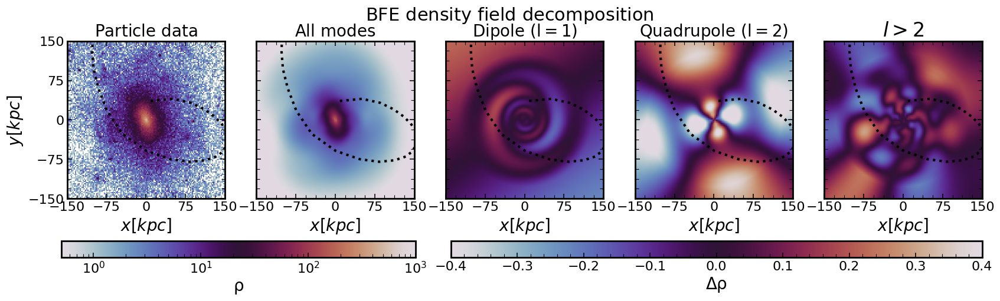

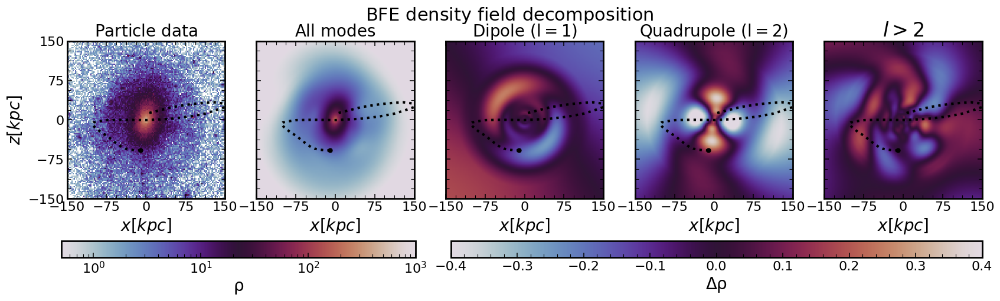

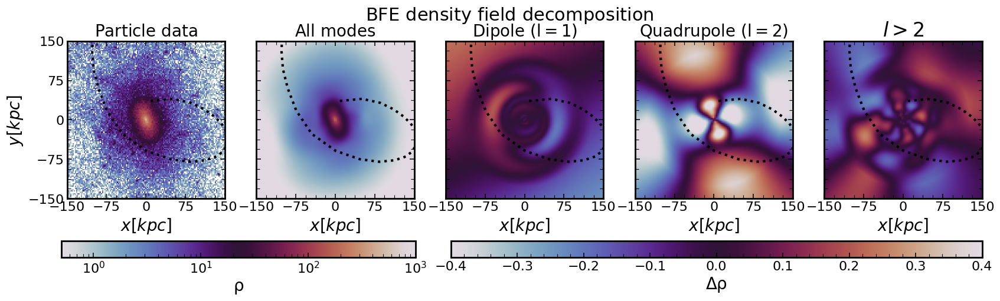

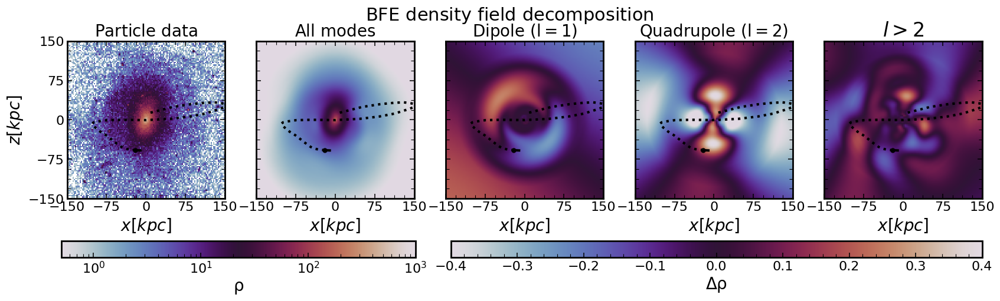

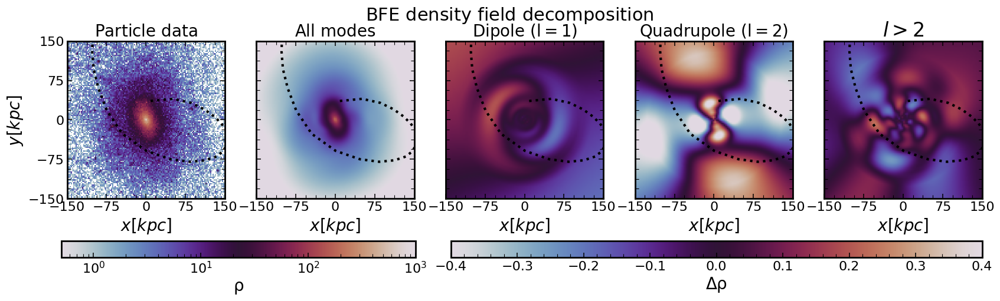

...

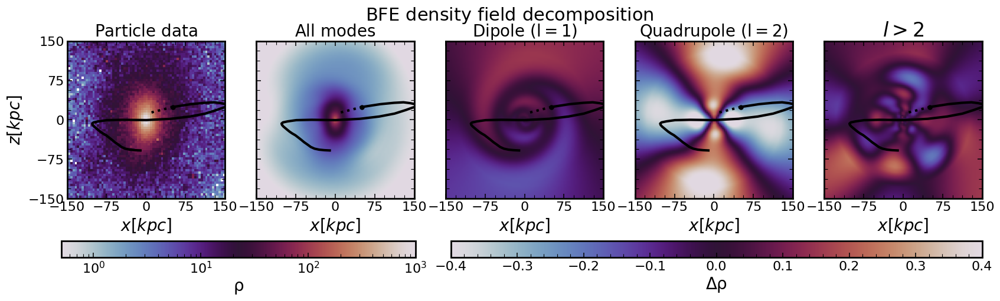

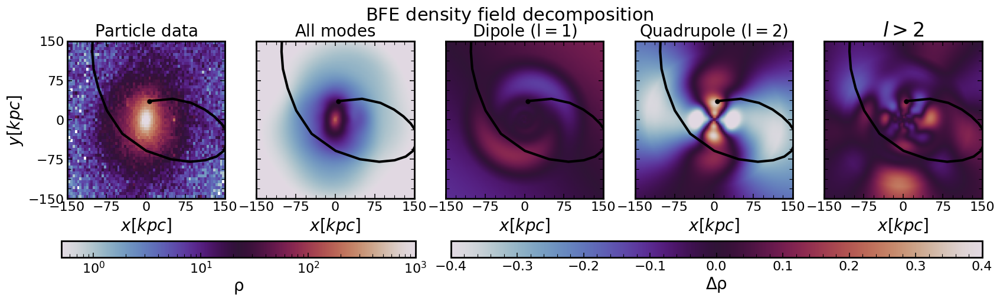

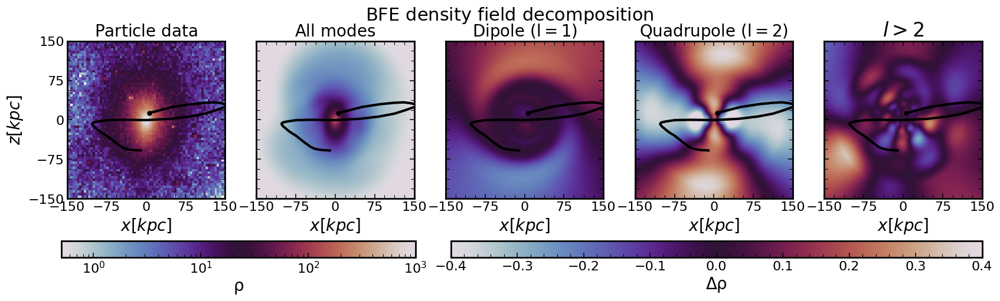

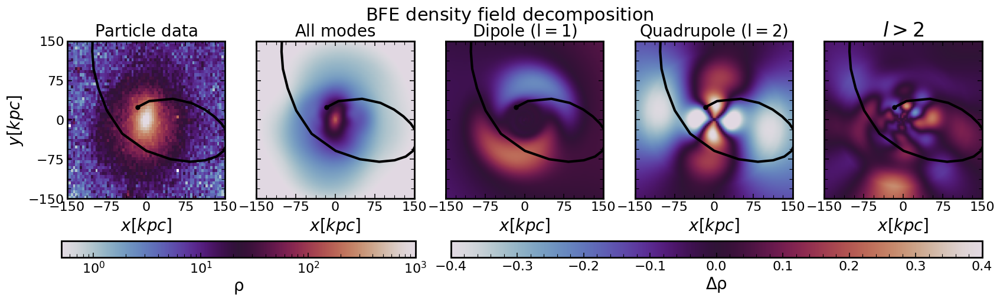

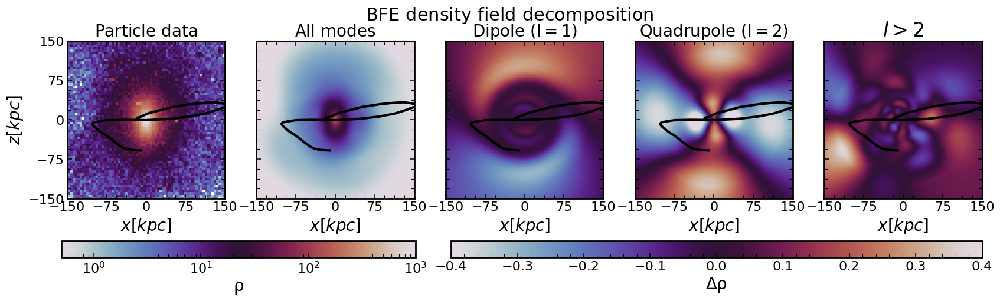

In [88]:
for f in ['dens', 'potential']:
    j=0
    for t in halo_coefs.Times():
        pos = load_halo(hh, snap+j)
        all_bfe_xy, mon_bfe_xy, non_mon_bfe_xy, dipole_xy, quad_xy = compute_surfaces(t, mwest_coefs, dipole_coefs, quad_coefs, proj='XY', field=f)
        BFE_density_decomposition_plot(pos, all_bfe_xy, mon_bfe_xy, dipole_xy, quad_xy, non_mon_bfe_xy, j, 'XY', halo=hh, field=f)
        all_bfe_xz, mon_bfe_xz, non_mon_bfe_xz, dipole_xz, quad_xz = compute_surfaces(t, mwest_coefs, dipole_coefs, quad_coefs, proj='XZ', field=f)
        BFE_density_decomposition_plot(pos, all_bfe_xz, mon_bfe_xz, dipole_xz, quad_xz, non_mon_bfe_xz, j, 'XZ', halo=hh, field=f)
        j+=1

In [90]:
os.system('ffmpeg -y -i \'BFE_decompostion_Halo349_proj_{0}_%03d.png\' movie_density_decomposition_{0}.mp4'.format('XY'));


ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena